# Turing Patterns

In *The Chemical Basis of Morphogenesis* (1952), Alan Turing explored the mathematical foundations of the development of living organisms. In particular, he focused on the curious patterns that appear in living organisms. Turing discovered that "dappled" patterns could be produced by choosing a random set of numbers $U \in \{-1, 1\}^{r \times s}$, and applying the following equation:
$$ f(x, y) = \sum{U_{r,s}} \exp \bigg(-\frac{1}{2}\big((x - hr)^2 + (y - hs)^2\big)\bigg)$$
using a value of $h = 0.7$ and an approximation of the exponential function (remember, Turing was working before calculators capable of calculating exponential functions were widely available!)

Let's define this function in NumPy:

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def turingLoop(h=0.7, maxVal=10, res=1000):
    # Generate randomized matrix
    U = np.sign(np.random.randn(2*maxVal, 2*maxVal))
    
    # Generate coordinate grid
    x = np.linspace(0, maxVal, res)
    X, Y = np.meshgrid(x, x)
    X = X.reshape((1, *X.shape))
    Y = Y.reshape((1, *Y.shape))
    Z = np.vstack((X,Y))

    def f(U, x, y):
        r, s = U.shape
        rs, ss = np.mgrid[0:r,0:s] # for indexing into U
        return np.sum(U * np.exp(-(1/2)*(((x - h*rs)**2) + ((y - h*ss)**2))))
    
    # Apply function f over coordinate grid
    Z = np.apply_along_axis(lambda x : f(U, *x), 0, Z)

    # Quantize values to {0, 1}
    return (np.sign(Z)+1)/2

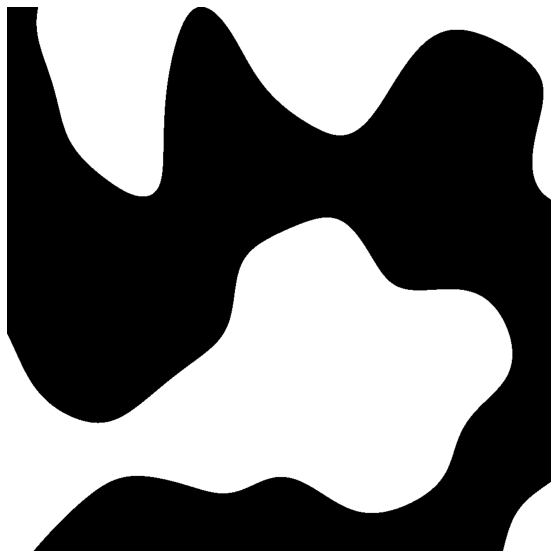

In [2]:
Z = turingLoop()
plt.figure(figsize=(10,10))
plt.axis('off')
plt.imshow(Z, cmap="gray")
plt.show()

In [3]:
def turingVectorized(h=0.7, maxVal=10, res=1000):
    U = np.sign(np.random.randn(2*maxVal, 2*maxVal))
    x = np.linspace(0, maxVal, res)
    X, Y = np.meshgrid(x, x)

    UTile = np.tile(U, (*X.shape, 1,1))
    UTile = np.moveaxis(UTile, [0,1,2,3], [2,3,0,1])
    XTile = np.tile(X, (*U.shape, 1, 1))
    YTile = np.tile(Y, (*U.shape, 1, 1))

    R, S = np.mgrid[:U.shape[0],:U.shape[1]]
    RTile = np.tile(R, (*X.shape, 1, 1))
    RTile = np.moveaxis(RTile, [0,1,2,3], [2,3,0,1])
    STile = np.tile(S, (*X.shape, 1, 1))
    STile = np.moveaxis(STile, [0,1,2,3], [2,3,0,1])

    Z = UTile * np.exp(-1/2 * ((XTile - h*RTile)**2 + (YTile - h*STile)**2))
    Z = np.sum(Z, axis=(0,1))
    return (np.sign(Z)+1)/2

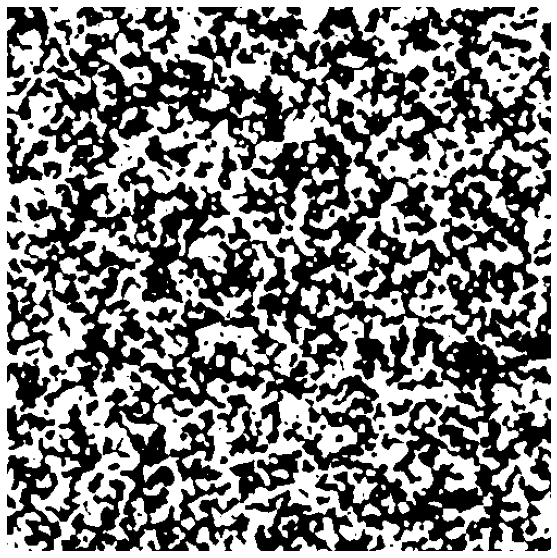

In [4]:
Z2 = turingLoop(maxVal=200, res=500)
plt.figure(figsize=(10,10))
plt.axis('off')
plt.imshow(Z2, cmap="gray")
plt.show()

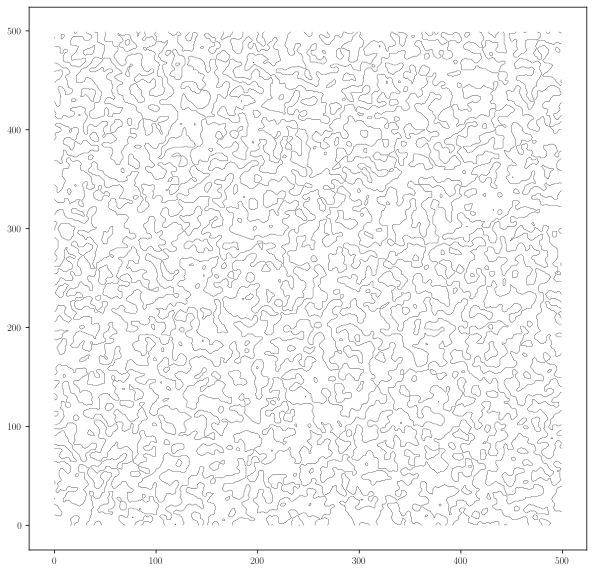

In [6]:
# %matplotlib notebook
%config InlineBackend.figure_format = 'svg'
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif"
})

from skimage.measure import find_contours
C = find_contours(Z2, 0.5)

plt.figure(figsize=(10,10))
for contour in C:
    plt.plot(contour[:, 1], contour[:, 0], c="k",linewidth=0.3)
plt.show()

In [7]:
from scipy.interpolate import splev, splprep

plt.figure(figsize=(10,10))

out = []
for c in C:
    uniq, index = np.unique(c, axis=0, return_index=True)
    u = uniq[index.argsort()]
    u = np.vstack((u, u[0]))
    if u.shape[0] < 4:
        continue
    if np.max(u) > 490 or np.min(u) < 10:
        continue
    x, y = u[:,0], u[:,1]
    #plt.scatter(x, y, s=0.4)
    tck, u = splprep([x, y], s=1)
    unew = np.arange(0, 1, 0.0005)
    out.append(splev(unew, tck))
    
for contour in out:
    plt.fill(*contour, c='black')
plt.xlim(0,500)
plt.ylim(0,500)
plt.show()

In [99]:
from numba import jit

@jit
def turingCore(U, x, y, z, h, rs, ss, ts):
    return np.sum(U * np.exp(-(1/2)*(((x - h*rs)**2) + ((y - h*ss)**2) + ((z - h*ts)**2))))


@jit(nopython=True)
def turingNumba(U, X, Y, Z, h, rs, ss, ts):
    R = np.zeros_like(X)
    for i in range(Z.shape[0]):
        for j in range(Z.shape[0]):
            for k in range(Z.shape[0]):
                x = X[i][j][k]
                y = Y[i][j][k]
                z = Z[i][j][k]
                R[i][j][k] = turingCore(U, x, y, z, h, rs, ss, ts) 
    return R

def turing3(h=0.3, maxVal=30, res=60):
    # Generate randomized matrix
    U = np.sign(np.random.randn(4*maxVal, 4*maxVal, 4*maxVal))
    r, s, t = U.shape
    rs, ss, ts = np.mgrid[0:r,0:s,0:t] # for indexing into U
    # Generate coordinate grid
    x = np.linspace(0, maxVal, res)
    X, Y, Z = np.meshgrid(x, x, x)
    return turingNumba(U, X, Y, Z, h, rs, ss, ts)

Z6 = turing3()

<IPython.core.display.Javascript object>


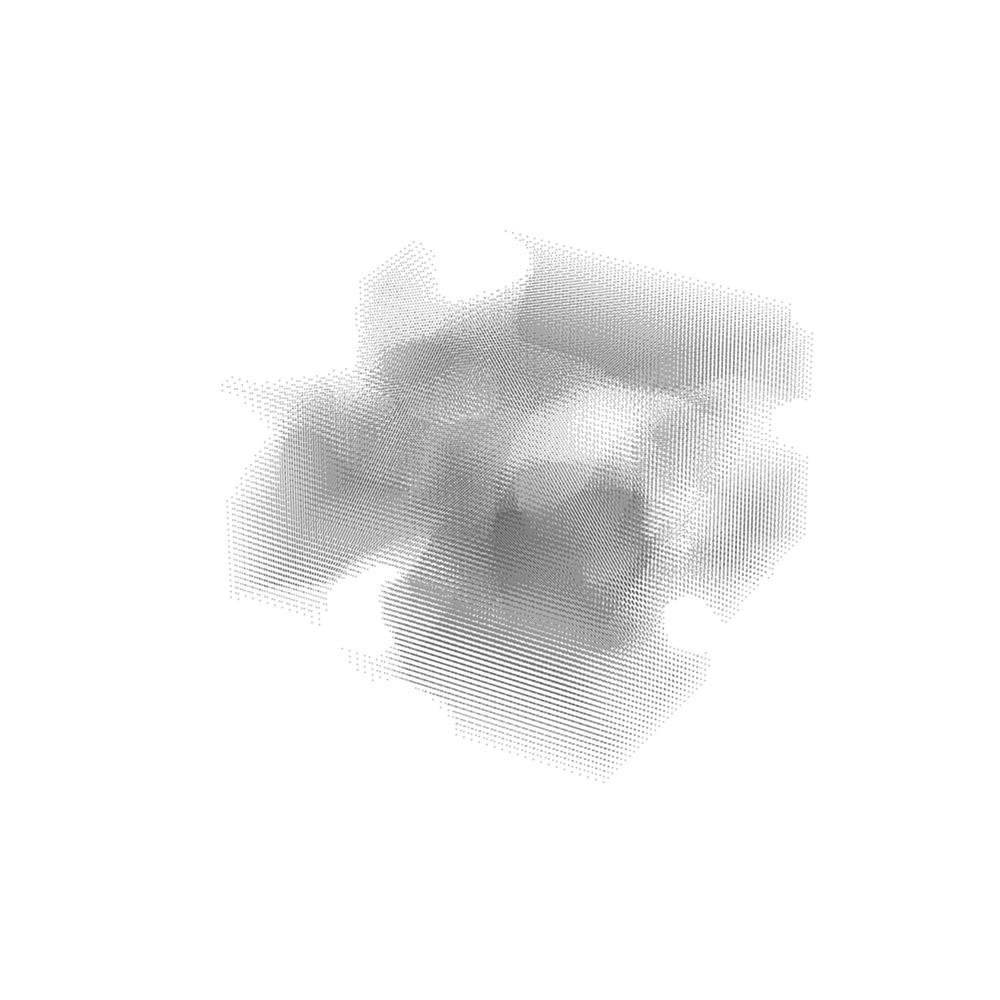

In [163]:
%matplotlib notebook

fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection ='3d')
ax.scatter(*np.where(Z4>0),alpha=0.2, s=.3, c='black')
plt.axis("off")
plt.savefig("turing3D_pointcloud.svg")
plt.show()

<IPython.core.display.Javascript object>


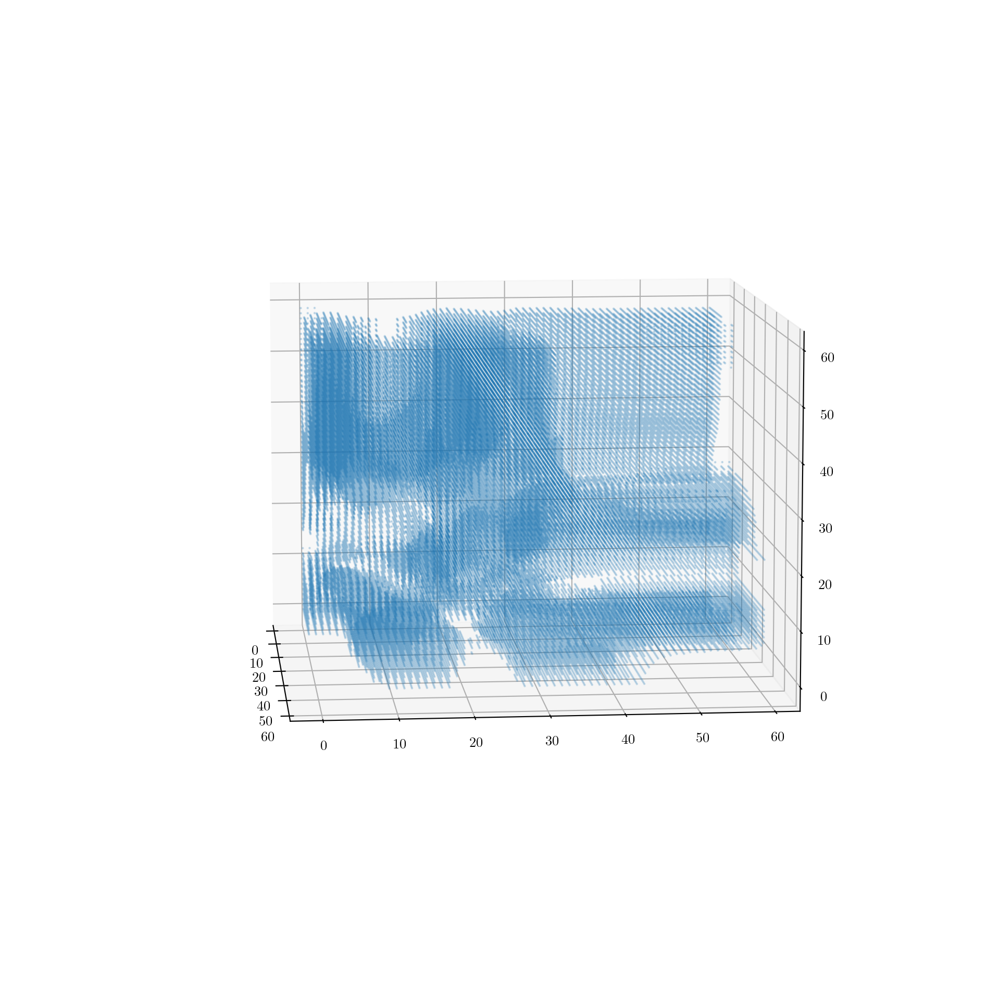

In [102]:
%matplotlib notebook

fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection ='3d')
ax.scatter(*np.where(Z5>0),alpha=0.2, s=.6)
plt.show()

In [103]:
Z6 = turing3()

<IPython.core.display.Javascript object>


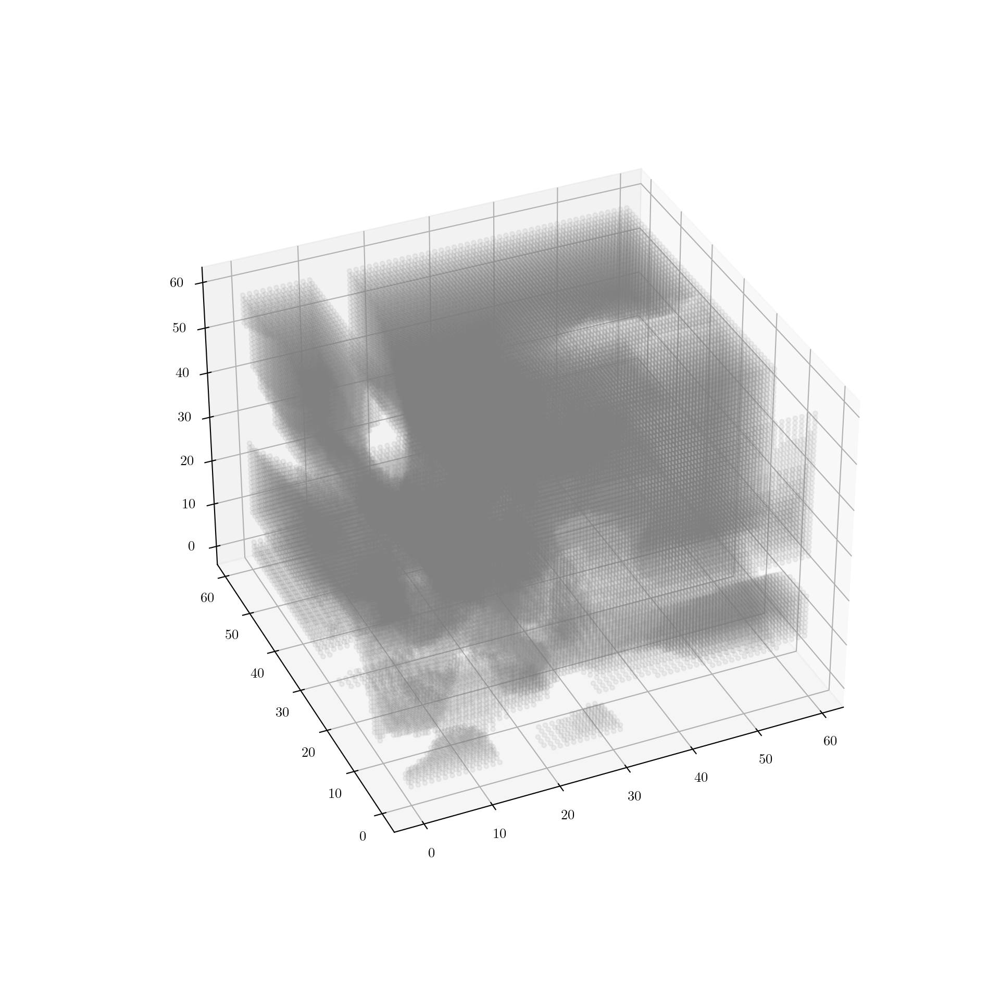

In [113]:
fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection ='3d')
coords = np.where(Z6[:30,:30,:30]>0)
randomized1 = coords + np.random.rand(len(coords), len(coords[0]))
randomized2 = coords + np.random.rand(len(coords), len(coords[0]))
ax.scatter(*np.where(Z6>0),alpha=0.1, s=10,c="gray")

plt.show()

In [114]:
Z7 = turing3(h=0.7, maxVal=50, res=100)

<IPython.core.display.Javascript object>


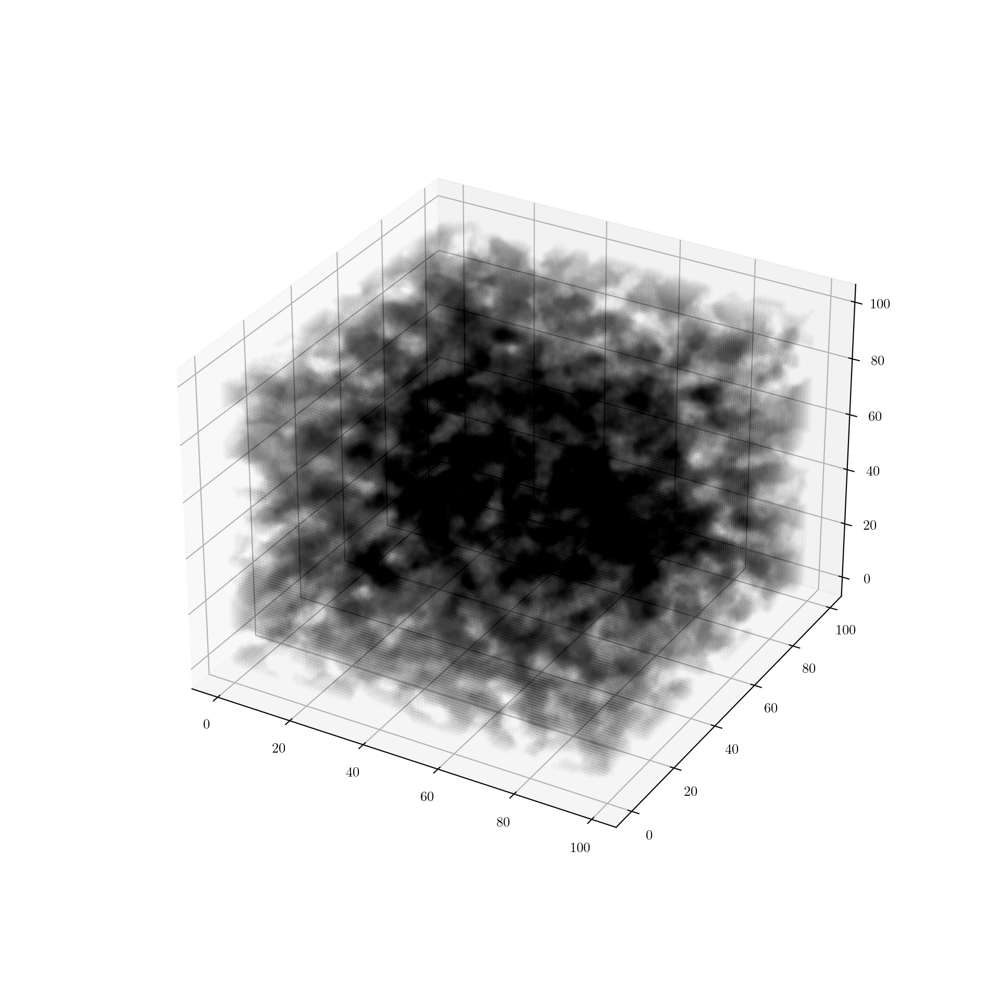

In [124]:
fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection ='3d')
ax.scatter(*np.where(Z7>0),alpha=0.01, s=10,c="black")
plt.show()

In [120]:
np.save("Z73d", Z7)

<IPython.core.display.Javascript object>


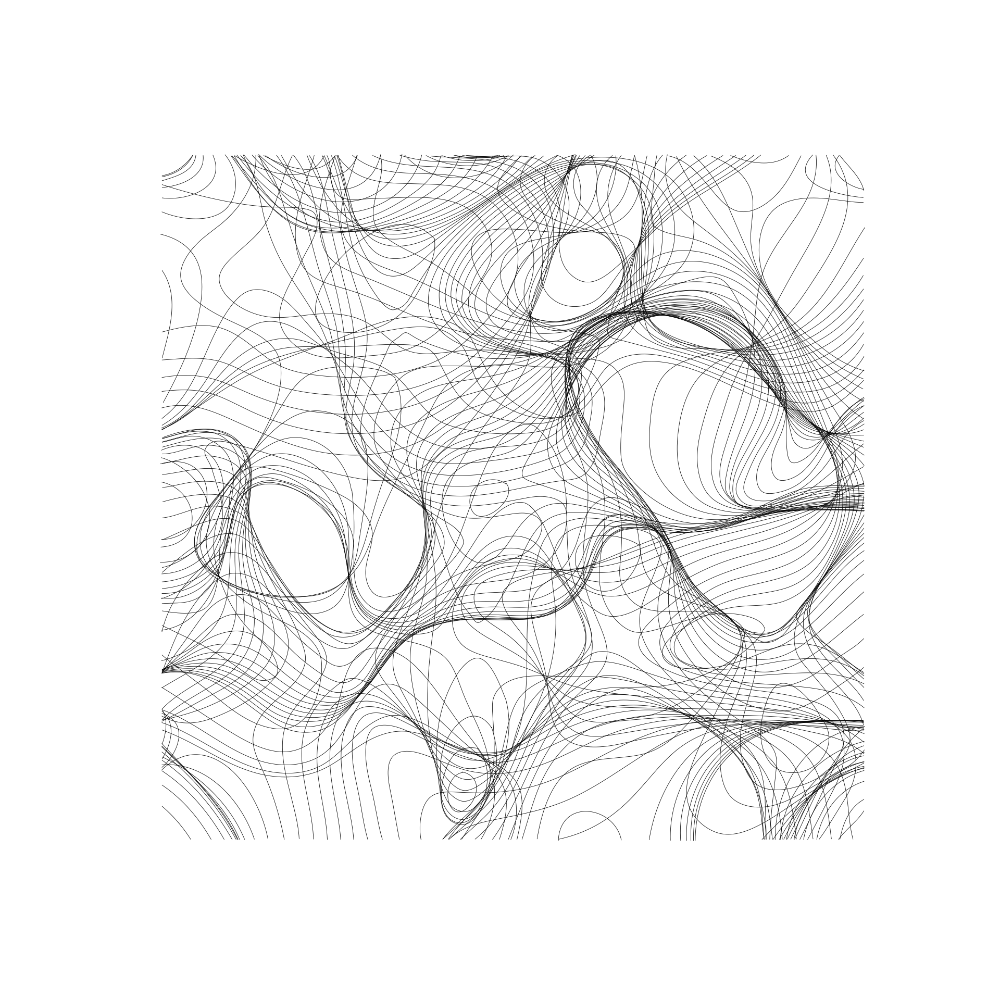

In [160]:
fig = plt.figure(figsize=(10,10))

for i, s in enumerate(Z4):
    cs = find_contours(s, 0.0)
    for c in cs:
        x, y = c[:,0], c[:,1]
        if len(x) < 5:
            continue
        tck, u = splprep([x, y], s=.1)
        unew = np.arange(0, 1, 0.00005)
        splines = splev(unew, tck)
        plt.plot(*splines, linewidth=0.3, c="black")
plt.axis('off')
plt.show()
plt.savefig("turing3D1.svg")

<IPython.core.display.Javascript object>


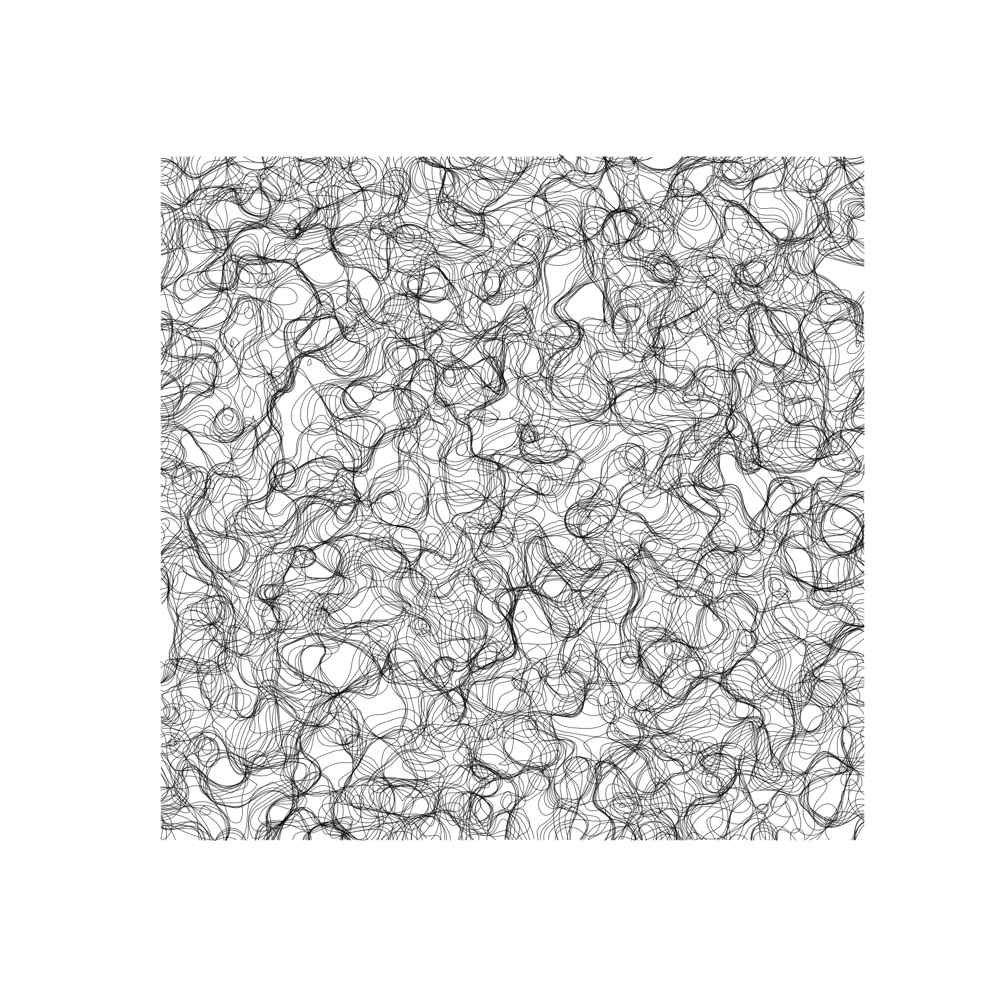

In [164]:
fig = plt.figure(figsize=(10,10))

Zslice = Z7[15:40,:,:]

for i, s in enumerate(Zslice):
    cs = find_contours(s, 0.0)
    for c in cs:
        x, y = c[:,0], c[:,1]
        if len(x) < 5:
            continue
        tck, u = splprep([x, y], s=.1)
        unew = np.arange(0, 1, 0.0005)
        splines = splev(unew, tck)
        plt.plot(*splines, linewidth=0.3, c="black")
plt.axis('off')
plt.savefig("turing3D2.svg")
plt.show()